In [2]:
!git clone https://github.com/annhchen89/CS441_FP.git
%cd CS441_FP
!ls


Cloning into 'CS441_FP'...
remote: Enumerating objects: 1460, done.
remote: Counting objects: 100% (71/71), done.
remote: Compressing objects: 100% (59/59), done.
remote: Total 1460 (delta 21), reused 54 (delta 12), pack-reused 1389 (from 2)
Receiving objects: 100% (1460/1460), 274.44 MiB | 68.33 MiB/s, done.
Resolving deltas: 100% (22/22), done.
/content/CS441_FP
dataset  own_testset  source.md


In [1]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [3]:
%%writefile train_resnet_food.py
import os
import json
import random
import argparse
from typing import List, Dict, Any

import numpy as np
from PIL import Image

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as T
import torchvision.models as models

from sklearn.metrics import f1_score, precision_score, recall_score


# ------------------------
# Utils: Reproducibility
# ------------------------
def set_seed(seed: int = 42):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False


# ------------------------
# Dataset
# ------------------------
class FoodMultiLabelDataset(Dataset):
    def __init__(
        self,
        samples: List[Dict[str, Any]],
        ingredient_to_idx: Dict[str, int],
        root_dir: str,
        transform=None,
    ):
        self.samples = samples
        self.ingredient_to_idx = ingredient_to_idx
        self.root_dir = root_dir
        self.transform = transform

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        item = self.samples[idx]
        rel_image_path = item["image"]  # e.g. "images/train/img0001.jpg"
        img_path = os.path.join(self.root_dir, rel_image_path)

        # Load image
        img = Image.open(img_path).convert("RGB")
        if self.transform is not None:
            img = self.transform(img)

        # Build multi-label vector
        num_classes = len(self.ingredient_to_idx)
        label_vec = np.zeros(num_classes, dtype=np.float32)

        # unique the ingredient list in case there are duplicates
        ingredients = list(set(item["ingredients"]))
        for ing in ingredients:
            if ing in self.ingredient_to_idx:
                label_vec[self.ingredient_to_idx[ing]] = 1.0

        label_tensor = torch.from_numpy(label_vec)  # shape [num_classes]

        return img, label_tensor


def load_label_json(label_path: str):
    with open(label_path, "r") as f:
        data = json.load(f)
    return data

def filter_missing_images(
    data: List[Dict[str, Any]], root_dir: str
) -> List[Dict[str, Any]]:
    """
    Remove samples whose image file does not exist.
    """
    filtered = []
    missing = 0
    for item in data:
        rel_path = item["image"]
        img_path = os.path.join(root_dir, rel_path)
        if os.path.exists(img_path):
            filtered.append(item)
        else:
            missing += 1
            print(f"[WARN] Missing image file, skipping: {img_path}")
    print(f"Filtered dataset: {len(filtered)} valid samples, {missing} missing.")
    return filtered

def build_ingredient_vocab(data: List[Dict[str, Any]]) -> Dict[str, int]:
    ingredients = set()
    for item in data:
        for ing in item["ingredients"]:
            ingredients.add(ing)
    ingredients = sorted(list(ingredients))
    ingredient_to_idx = {ing: i for i, ing in enumerate(ingredients)}
    return ingredient_to_idx


def split_by_field(
    data: List[Dict[str, Any]], split_name: str
) -> List[Dict[str, Any]]:
    return [x for x in data if x.get("split") == split_name]


# ------------------------
# Metrics for Multi-label
# ------------------------
def compute_multilabel_metrics(
    y_true: np.ndarray, y_pred_logits: np.ndarray, threshold: float = 0.5
) -> Dict[str, float]:
    """
    y_true: shape [N, C] with {0,1}
    y_pred_logits: shape [N, C] raw logits
    """
    # Convert logits to probabilities with sigmoid, then to binary predictions
    y_pred_prob = 1 / (1 + np.exp(-y_pred_logits))
    y_pred = (y_pred_prob >= threshold).astype(int)


    metrics = {}

    # micro
    metrics["micro_f1"] = f1_score(y_true, y_pred, average="micro", zero_division=0)
    metrics["micro_precision"] = precision_score(
        y_true, y_pred, average="micro", zero_division=0
    )
    metrics["micro_recall"] = recall_score(
        y_true, y_pred, average="micro", zero_division=0
    )

    # macro
    metrics["macro_f1"] = f1_score(y_true, y_pred, average="macro", zero_division=0)
    metrics["macro_precision"] = precision_score(
        y_true, y_pred, average="macro", zero_division=0
    )
    metrics["macro_recall"] = recall_score(
        y_true, y_pred, average="macro", zero_division=0
    )

    return metrics
def find_best_threshold(
    y_true: np.ndarray,
    y_logits: np.ndarray,
    thresholds: np.ndarray = np.linspace(0.1, 0.9, 17)
):
    """
    Search for the threshold that gives the best micro-F1 on validation.
    y_true:  [N, C] with {0,1}
    y_logits:[N, C] raw logits
    """
    best_t = 0.5
    best_f1 = -1.0
    best_metrics = None

    for t in thresholds:
        metrics = compute_multilabel_metrics(y_true, y_logits, threshold=float(t))
        f1 = metrics["micro_f1"]
        if f1 > best_f1:
            best_f1 = f1
            best_t = float(t)
            best_metrics = metrics

    return best_t, best_metrics


# ------------------------
# ResNet Model builders
# ------------------------
def build_resnet(
    model_type: str, num_classes: int
) -> nn.Module:
    """
    model_type: 'resnet_scratch', 'resnet_pretrained_frozen', 'resnet_pretrained_finetune'
    """
    if model_type not in {
        "resnet_scratch",
        "resnet_pretrained_frozen",
        "resnet_pretrained_finetune",
    }:
        raise ValueError(f"Unknown model_type: {model_type}")

    # ResNet18 is a good size for this project
    if model_type == "resnet_scratch":
        resnet = models.resnet18(weights=None)
    else:
        # Pretrained on ImageNet
        weights = models.ResNet18_Weights.IMAGENET1K_V1
        resnet = models.resnet18(weights=weights)

    # Replace the final fully-connected layer
    in_features = resnet.fc.in_features
    resnet.fc = nn.Linear(in_features, num_classes)

    if model_type == "resnet_pretrained_frozen":
        # Freeze all except final fc
        for name, param in resnet.named_parameters():
            if not name.startswith("fc."):
                param.requires_grad = False

    if model_type == "resnet_pretrained_finetune":
        # All params trainable (we could also choose to unfreeze only last layers)
        for param in resnet.parameters():
            param.requires_grad = True

    return resnet


# ------------------------
# Training / Evaluation Loop
# ------------------------
def train_one_epoch(
    model,
    dataloader,
    optimizer,
    criterion,
    device,
):
    model.train()
    total_loss = 0.0
    num_batches = 0

    for images, targets in dataloader:
        images = images.to(device)
        targets = targets.to(device)

        optimizer.zero_grad()
        logits = model(images)  # shape [B, num_classes]
        loss = criterion(logits, targets)
        loss.backward()
        optimizer.step()

        total_loss += loss.item()
        num_batches += 1

    return total_loss / max(num_batches, 1)


@torch.no_grad()
def eval_model(
    model,
    dataloader,
    criterion,
    device,
):
    model.eval()
    total_loss = 0.0
    num_batches = 0

    all_logits = []
    all_targets = []

    for images, targets in dataloader:
        images = images.to(device)
        targets = targets.to(device)

        logits = model(images)
        loss = criterion(logits, targets)

        total_loss += loss.item()
        num_batches += 1

        all_logits.append(logits.cpu().numpy())
        all_targets.append(targets.cpu().numpy())

    avg_loss = total_loss / max(num_batches, 1)
    if len(all_logits) > 0:
        all_logits = np.concatenate(all_logits, axis=0)
        all_targets = np.concatenate(all_targets, axis=0)
        metrics = compute_multilabel_metrics(all_targets, all_logits)
    else:
        metrics = {}

    return avg_loss, metrics, all_logits, all_targets


# ------------------------
# Main
# ------------------------
def main():
    parser = argparse.ArgumentParser()
    parser.add_argument(
        "--dataset_root",
        type=str,
        default="CS441_FP/dataset",
        help="Root directory containing label.json and images/",
    )
    parser.add_argument(
        "--label_json",
        type=str,
        default="label.json",
        help="Name of the label json file inside dataset_root",
    )
    parser.add_argument(
        "--model_type",
        type=str,
        default="resnet_pretrained_finetune",
        choices=[
            "resnet_scratch",
            "resnet_pretrained_frozen",
            "resnet_pretrained_finetune",
        ],
        help="Which ResNet variant to train",
    )
    parser.add_argument("--batch_size", type=int, default=32)
    parser.add_argument("--epochs", type=int, default=15)
    parser.add_argument("--lr", type=float, default=1e-3)
    parser.add_argument("--weight_decay", type=float, default=1e-4)
    parser.add_argument(
        "--num_workers", type=int, default=4, help="DataLoader num_workers"
    )
    parser.add_argument("--seed", type=int, default=42)
    parser.add_argument(
        "--save_dir", type=str, default="checkpoints", help="Where to save models"
    )
    args = parser.parse_args()

    set_seed(args.seed)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")

    # Load label.json
    label_path = os.path.join(args.dataset_root, args.label_json)
    data = load_label_json(label_path)

    # Filter out samples with missing image files
    data = filter_missing_images(data, args.dataset_root)

    # Build vocabulary
    ingredient_to_idx = build_ingredient_vocab(data)

    idx_to_ingredient = {v: k for k, v in ingredient_to_idx.items()}
    num_classes = len(ingredient_to_idx)
    print(f"Found {num_classes} ingredient classes.")
    print("Ingredient -> index mapping:")
    for ing, idx in ingredient_to_idx.items():
        print(f"  {ing}: {idx}")

    # Optionally save mapping for reuse
    os.makedirs(args.save_dir, exist_ok=True)
    mapping_path = os.path.join(args.save_dir, "ingredient_to_idx.json")
    with open(mapping_path, "w") as f:
        json.dump(ingredient_to_idx, f, indent=2)

    # Build splits based on "split" field in JSON
    train_samples = split_by_field(data, "train")
    val_samples = split_by_field(data, "val")
    test_samples = split_by_field(data, "test")

    print(f"Train samples: {len(train_samples)}")
    print(f"Val samples:   {len(val_samples)}")
    print(f"Test samples:  {len(test_samples)}")

    # Transforms (can tweak later)
    train_transform = T.Compose(
        [
            T.Resize((256, 256)),
            T.RandomResizedCrop(224),
            T.RandomHorizontalFlip(),
            T.ToTensor(),
            T.Normalize(
                mean=[0.485, 0.456, 0.406],
                std=[0.229, 0.224, 0.225],
            ),
        ]
    )
    eval_transform = T.Compose(
        [
            T.Resize((256, 256)),
            T.CenterCrop(224),
            T.ToTensor(),
            T.Normalize(
                mean=[0.485, 0.456, 0.406],
                std=[0.229, 0.224, 0.225],
            ),
        ]
    )

    # Datasets
    train_dataset = FoodMultiLabelDataset(
        train_samples, ingredient_to_idx, args.dataset_root, transform=train_transform
    )
    val_dataset = FoodMultiLabelDataset(
        val_samples, ingredient_to_idx, args.dataset_root, transform=eval_transform
    )
    test_dataset = FoodMultiLabelDataset(
        test_samples, ingredient_to_idx, args.dataset_root, transform=eval_transform
    )

    # Dataloaders
    train_loader = DataLoader(
        train_dataset,
        batch_size=args.batch_size,
        shuffle=True,
        num_workers=args.num_workers,
        pin_memory=True,
    )
    val_loader = DataLoader(
        val_dataset,
        batch_size=args.batch_size,
        shuffle=False,
        num_workers=args.num_workers,
        pin_memory=True,
    )
    test_loader = DataLoader(
        test_dataset,
        batch_size=args.batch_size,
        shuffle=False,
        num_workers=args.num_workers,
        pin_memory=True,
    )

    # Build model
    model = build_resnet(args.model_type, num_classes=num_classes)
    model = model.to(device)

    # Only optimize parameters that require grad
    params_to_optimize = [p for p in model.parameters() if p.requires_grad]
    optimizer = torch.optim.AdamW(
        params_to_optimize, lr=args.lr, weight_decay=args.weight_decay
    )
    criterion = nn.BCEWithLogitsLoss()

    # Training loop
    best_val_micro_f1 = -1.0
    best_model_path = os.path.join(
        args.save_dir, f"{args.model_type}_best.pt"
    )

    for epoch in range(1, args.epochs + 1):
        print(f"\nEpoch {epoch}/{args.epochs}")
        train_loss = train_one_epoch(
            model, train_loader, optimizer, criterion, device
        )
        print(f"Train loss: {train_loss:.4f}")

        val_loss, val_metrics, _, _ = eval_model(
            model, val_loader, criterion, device
        )

        print(f"Val loss: {val_loss:.4f}")
        if val_metrics:
            print(
                f"Val micro-F1: {val_metrics['micro_f1']:.4f}, "
                f"macro-F1: {val_metrics['macro_f1']:.4f}"
            )

        # Track best by validation micro-F1
        current_micro_f1 = val_metrics.get("micro_f1", 0.0)
        if current_micro_f1 > best_val_micro_f1:
            best_val_micro_f1 = current_micro_f1
            torch.save(
                {
                    "model_state_dict": model.state_dict(),
                    "ingredient_to_idx": ingredient_to_idx,
                    "idx_to_ingredient": idx_to_ingredient,
                    "model_type": args.model_type,
                },
                best_model_path,
            )
            print(f"  >>> New best model saved to {best_model_path}")

    # Load best model for final evaluation
    if os.path.exists(best_model_path):
        checkpoint = torch.load(best_model_path, map_location=device)
        model.load_state_dict(checkpoint["model_state_dict"])
        print(f"\nLoaded best model from {best_model_path} for final evaluation.")

    # 1) Evaluate on VAL and find best threshold
    val_loss_final, _, val_logits, val_targets = eval_model(
        model, val_loader, criterion, device
    )
    best_t, best_val_metrics = find_best_threshold(val_targets, val_logits)

    print("\n=== Validation (threshold tuning) ===")
    print(f"Val loss (final model): {val_loss_final:.4f}")
    print(f"Best threshold on val: {best_t:.3f}")
    print(
        f"Val micro-F1: {best_val_metrics['micro_f1']:.4f}, "
        f"macro-F1: {best_val_metrics['macro_f1']:.4f}"
    )
    print(
        f"Val micro-Precision: {best_val_metrics['micro_precision']:.4f}, "
        f"micro-Recall: {best_val_metrics['micro_recall']:.4f}"
    )
    print(
        f"Val macro-Precision: {best_val_metrics['macro_precision']:.4f}, "
        f"macro-Recall: {best_val_metrics['macro_recall']:.4f}"
    )

    # 2) Evaluate on TEST using the best threshold from val
    test_loss, _, test_logits, test_targets = eval_model(
        model, test_loader, criterion, device
    )
    test_metrics = compute_multilabel_metrics(
        test_targets, test_logits, threshold=best_t
    )

    print("\n=== Final Test Results (using tuned threshold) ===")
    print(f"Test loss: {test_loss:.4f}")
    print(f"Test micro-F1: {test_metrics['micro_f1']:.4f}")
    print(f"Test macro-F1: {test_metrics['macro_f1']:.4f}")
    print(f"Test micro-Precision: {test_metrics['micro_precision']:.4f}")
    print(f"Test micro-Recall: {test_metrics['micro_recall']:.4f}")
    print(f"Test macro-Precision: {test_metrics['macro_precision']:.4f}")
    print(f"Test macro-Recall: {test_metrics['macro_recall']:.4f}")

    # Optionally, save raw logits/targets and best_t for later analysis
    np.save(os.path.join(args.save_dir, f"{args.model_type}_test_logits.npy"), test_logits)
    np.save(os.path.join(args.save_dir, f"{args.model_type}_test_targets.npy"), test_targets)
    with open(os.path.join(args.save_dir, f"{args.model_type}_best_threshold.txt"), "w") as f:
        f.write(str(best_t))


if __name__ == "__main__":
    main()


Writing train_resnet_food.py


In [4]:
!pip install torch torchvision scikit-learn


In [ ]:
!python /content/CS441_FP/train_resnet_food.py \
  --dataset_root /content/CS441_FP/dataset \
  --model_type resnet_pretrained_frozen \
  --epochs 15 \
  --save_dir /content/drive/MyDrive/CS441_FP/checkpoints_resnet


Using device: cuda
[WARN] Missing image file, skipping: /content/CS441_FP/dataset/images/train/img0452.jpg
Filtered dataset: 997 valid samples, 1 missing.
Found 71 ingredient classes.
Ingredient -> index mapping:
  almond: 0
  apple: 1
  arugula: 2
  asparagus: 3
  avocado: 4
  bacon: 5
  banana: 6
  beef: 7
  bell pepper: 8
  blueberry: 9
  bread: 10
  broccoli: 11
  butter: 12
  cabbage: 13
  carrot: 14
  cashew: 15
  cheese: 16
  chicken: 17
  chickpeas: 18
  chili: 19
  corn: 20
  crab: 21
  cream: 22
  cucumber: 23
  curry: 24
  edamame: 25
  egg: 26
  fish: 27
  garlic: 28
  ginger: 29
  gnocchi: 30
  ham: 31
  kiwi: 32
  lamb: 33
  lemon: 34
  lettuce: 35
  mango: 36
  milk: 37
  mushroom: 38
  noodles: 39
  oat: 40
  oil: 41
  onion: 42
  orange: 43
  parsley: 44
  pasta: 45
  peanut: 46
  pineapple: 47
  pork: 48
  potato: 49
  pumpkin: 50
  raspberry: 51
  rice: 52
  salmon: 53
  sausage: 54
  scallion: 55
  seaweed: 56
  sesame: 57
  shellfish: 58
  shrimp: 59
  soy: 60
  sp

In [ ]:
# 1) ResNet18 trained FROM SCRATCH (no ImageNet pretraining)
!python /content/CS441_FP/train_resnet_food.py \
  --dataset_root /content/CS441_FP/dataset \
  --model_type resnet_scratch \
  --epochs 15 \
  --save_dir /content/drive/MyDrive/CS441_FP/checkpoints_resnet


Using device: cuda
[WARN] Missing image file, skipping: /content/CS441_FP/dataset/images/train/img0452.jpg
Filtered dataset: 997 valid samples, 1 missing.
Found 71 ingredient classes.
Ingredient -> index mapping:
  almond: 0
  apple: 1
  arugula: 2
  asparagus: 3
  avocado: 4
  bacon: 5
  banana: 6
  beef: 7
  bell pepper: 8
  blueberry: 9
  bread: 10
  broccoli: 11
  butter: 12
  cabbage: 13
  carrot: 14
  cashew: 15
  cheese: 16
  chicken: 17
  chickpeas: 18
  chili: 19
  corn: 20
  crab: 21
  cream: 22
  cucumber: 23
  curry: 24
  edamame: 25
  egg: 26
  fish: 27
  garlic: 28
  ginger: 29
  gnocchi: 30
  ham: 31
  kiwi: 32
  lamb: 33
  lemon: 34
  lettuce: 35
  mango: 36
  milk: 37
  mushroom: 38
  noodles: 39
  oat: 40
  oil: 41
  onion: 42
  orange: 43
  parsley: 44
  pasta: 45
  peanut: 46
  pineapple: 47
  pork: 48
  potato: 49
  pumpkin: 50
  raspberry: 51
  rice: 52
  salmon: 53
  sausage: 54
  scallion: 55
  seaweed: 56
  sesame: 57
  shellfish: 58
  shrimp: 59
  soy: 60
  sp

In [ ]:
# 2) ResNet18 PRETRAINED + FINETUNED (full network trainable)
!python /content/CS441_FP/train_resnet_food.py \
  --dataset_root /content/CS441_FP/dataset \
  --model_type resnet_pretrained_finetune \
  --epochs 15 \
  --save_dir /content/drive/MyDrive/CS441_FP/checkpoints_resnet


Using device: cuda
[WARN] Missing image file, skipping: /content/CS441_FP/dataset/images/train/img0452.jpg
Filtered dataset: 997 valid samples, 1 missing.
Found 71 ingredient classes.
Ingredient -> index mapping:
  almond: 0
  apple: 1
  arugula: 2
  asparagus: 3
  avocado: 4
  bacon: 5
  banana: 6
  beef: 7
  bell pepper: 8
  blueberry: 9
  bread: 10
  broccoli: 11
  butter: 12
  cabbage: 13
  carrot: 14
  cashew: 15
  cheese: 16
  chicken: 17
  chickpeas: 18
  chili: 19
  corn: 20
  crab: 21
  cream: 22
  cucumber: 23
  curry: 24
  edamame: 25
  egg: 26
  fish: 27
  garlic: 28
  ginger: 29
  gnocchi: 30
  ham: 31
  kiwi: 32
  lamb: 33
  lemon: 34
  lettuce: 35
  mango: 36
  milk: 37
  mushroom: 38
  noodles: 39
  oat: 40
  oil: 41
  onion: 42
  orange: 43
  parsley: 44
  pasta: 45
  peanut: 46
  pineapple: 47
  pork: 48
  potato: 49
  pumpkin: 50
  raspberry: 51
  rice: 52
  salmon: 53
  sausage: 54
  scallion: 55
  seaweed: 56
  sesame: 57
  shellfish: 58
  shrimp: 59
  soy: 60
  sp

In [ ]:
import numpy as np
from sklearn.metrics import f1_score, precision_score, recall_score
import pandas as pd

save_dir = "/content/drive/MyDrive/CS441_FP/checkpoints_resnet"
model_types = [
    "resnet_scratch",
    "resnet_pretrained_frozen",
    "resnet_pretrained_finetune",
]

def compute_metrics(y_true, y_logits, threshold):
    probs = 1 / (1 + np.exp(-y_logits))
    y_pred = (probs >= threshold).astype(int)
    return {
        "threshold": threshold,
        "micro_f1": f1_score(y_true, y_pred, average="micro", zero_division=0),
        "macro_f1": f1_score(y_true, y_pred, average="macro", zero_division=0),
        "micro_precision": precision_score(y_true, y_pred, average="micro", zero_division=0),
        "micro_recall": recall_score(y_true, y_pred, average="micro", zero_division=0),
        "macro_precision": precision_score(y_true, y_pred, average="macro", zero_division=0),
        "macro_recall": recall_score(y_true, y_pred, average="macro", zero_division=0),
    }

rows = []

for model_type in model_types:
    print(f"\n=== {model_type} ===")
    logits = np.load(f"{save_dir}/{model_type}_test_logits.npy")
    targets = np.load(f"{save_dir}/{model_type}_test_targets.npy")
    with open(f"{save_dir}/{model_type}_best_threshold.txt") as f:
        best_t = float(f.read().strip())

    # default threshold 0.5
    m_default = compute_metrics(targets, logits, threshold=0.5)
    # tuned threshold
    m_tuned = compute_metrics(targets, logits, threshold=best_t)

    print("  default 0.5:", m_default)
    print("  tuned", best_t, ":", m_tuned)

    rows.append({
        "model": model_type,
        "setting": "default_0.5",
        **m_default,
    })
    rows.append({
        "model": model_type,
        "setting": f"tuned_{best_t:.2f}",
        **m_tuned,
    })

df = pd.DataFrame(rows)
df



=== resnet_scratch ===
  default 0.5: {'threshold': 0.5, 'micro_f1': 0.14025974025974025, 'macro_f1': 0.040675971012082375, 'micro_precision': 0.38028169014084506, 'micro_recall': 0.08598726114649681, 'macro_precision': 0.061660203385555494, 'macro_recall': 0.036547094328316765}
  tuned 0.15000000000000002 : {'threshold': 0.15000000000000002, 'micro_f1': 0.24443344878772885, 'macro_f1': 0.10460568894808794, 'micro_precision': 0.1773151471643934, 'micro_recall': 0.39331210191082805, 'macro_precision': 0.09408436889632675, 'macro_recall': 0.19326471684049437}

=== resnet_pretrained_frozen ===
  default 0.5: {'threshold': 0.5, 'micro_f1': 0.17486338797814208, 'macro_f1': 0.061469604774127155, 'micro_precision': 0.6153846153846154, 'micro_recall': 0.10191082802547771, 'macro_precision': 0.13159766680893442, 'macro_recall': 0.0454720772838206}
  tuned 0.2 : {'threshold': 0.2, 'micro_f1': 0.33467417538214, 'macro_f1': 0.16038069086543164, 'micro_precision': 0.3382113821138211, 'micro_recall

,model,setting,threshold,micro_f1,macro_f1,micro_precision,micro_recall,macro_precision,macro_recall
0,resnet_scratch,default_0.5,0.50,0.140260,0.040676,0.380282,0.085987,0.061660,0.036547
1,resnet_scratch,tuned_0.15,0.15,0.244433,0.104606,0.177315,0.393312,0.094084,0.193265
2,resnet_pretrained_frozen,default_0.5,0.50,0.174863,0.061470,0.615385,0.101911,0.131598,0.045472
3,resnet_pretrained_frozen,tuned_0.20,0.20,0.334674,0.160381,0.338211,0.331210,0.202349,0.173955
4,resnet_pretrained_finetune,default_0.5,0.50,0.275269,0.100104,0.423841,0.203822,0.151478,0.094478
5,resnet_pretrained_finetune,tuned_0.25,0.25,0.315379,0.152750,0.309342,0.321656,0.175837,0.175083


Using device: cuda
Loading checkpoint: /content/drive/MyDrive/CS441_FP/checkpoints_resnet/resnet_pretrained_finetune_best.pt
Using threshold: 0.25


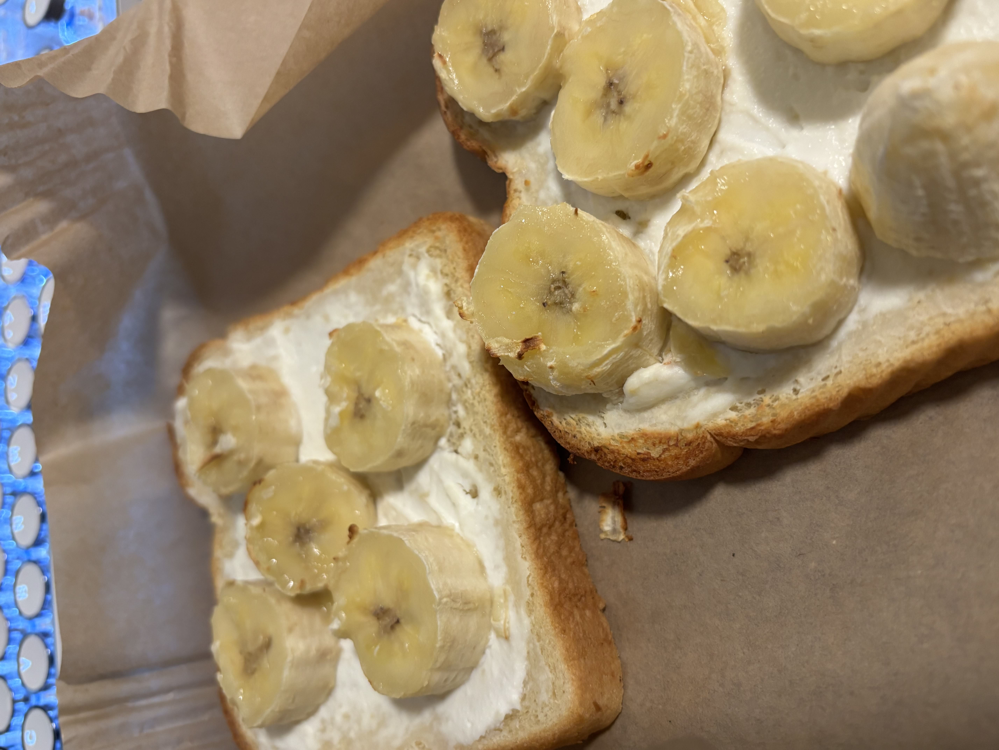

Test image: /content/CS441_FP/own_testset/IMG_5570.jpg

Predicted ingredients (>= threshold):
  gnocchi       prob=0.740
  pasta         prob=0.307
  cream         prob=0.276

=== Summary for user ===
- The model thinks this dish contains: gnocchi, pasta, cream.
- If you have food allergies, you should be careful about: dairy, wheat.


In [11]:
import torch
import torchvision.transforms as T
from PIL import Image
import numpy as np
import json
import os
import sys
from IPython.display import display

# ======= Config =======
project_root = "/content/CS441_FP"  # change if needed
checkpoint_dir = "/content/drive/MyDrive/CS441_FP/checkpoints_resnet"
model_type = "resnet_pretrained_finetune"  # or "resnet_pretrained_finetune", etc.

# Pick one test image (update this path to a real test image)
test_image_path = f"{project_root}/own_testset/IMG_5570.jpg"

mapping_path = f"{project_root}/dataset/mapping.json"

# ======================
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

# Make sure we can import the training script
sys.path.append(project_root)
from train_resnet_food import build_resnet

# --- load checkpoint ---
ckpt_path = os.path.join(checkpoint_dir, f"{model_type}_best.pt")
print("Loading checkpoint:", ckpt_path)
ckpt = torch.load(ckpt_path, map_location=device)

ingredient_to_idx = ckpt["ingredient_to_idx"]
idx_to_ingredient = {int(k): v for k, v in ckpt["idx_to_ingredient"].items()}
num_classes = len(ingredient_to_idx)

# --- load best threshold ---
thr_path = os.path.join(checkpoint_dir, f"{model_type}_best_threshold.txt")
with open(thr_path) as f:
    best_t = float(f.read().strip())
print("Using threshold:", best_t)

# --- rebuild model and load weights ---
model = build_resnet(model_type, num_classes=num_classes)
model.load_state_dict(ckpt["model_state_dict"])
model.to(device)
model.eval()

# --- eval transforms (same as during validation/test) ---
transform = T.Compose([
    T.Resize((256, 256)),
    T.CenterCrop(224),
    T.ToTensor(),
    T.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225],
    ),
])

# --- load ingredient -> allergen mapping ---
with open(mapping_path, "r") as f:
    ingredient_to_allergen = json.load(f)

def predict_image_with_allergens(path):
    img = Image.open(path).convert("RGB")
    x = transform(img).unsqueeze(0).to(device)  # [1, C, H, W]

    with torch.no_grad():
        logits = model(x)              # [1, num_classes]
        probs = torch.sigmoid(logits)  # convert logits to probabilities
        probs = probs.cpu().numpy()[0]

    # indices above threshold
    pred_indices = np.where(probs >= best_t)[0]
    pred_ings = [(idx_to_ingredient[int(i)], float(probs[i])) for i in pred_indices]
    pred_ings = sorted(pred_ings, key=lambda x: x[1], reverse=True)

    # map ingredients -> allergens
    allergens = []
    for name, _ in pred_ings:
        if name in ingredient_to_allergen:
            allergens.append(ingredient_to_allergen[name])
    allergens = sorted(set(allergens))

    return img, pred_ings, allergens

# ---------- RUN IT ----------
img, predicted_ingredients, predicted_allergens = predict_image_with_allergens(test_image_path)

display(img)
print("Test image:", test_image_path)

print("\nPredicted ingredients (>= threshold):")
if predicted_ingredients:
    for name, p in predicted_ingredients:
        print(f"  {name:12s}  prob={p:.3f}")
else:
    print("  (no ingredients above threshold)")

# Build nice summary sentences
ingredient_names = [name for name, _ in predicted_ingredients]

print("\n=== Summary for user ===")
if ingredient_names:
    ing_str = ", ".join(ingredient_names)
    print(f"- The model thinks this dish contains: {ing_str}.")
else:
    print("- The model is not confident about any specific ingredients.")

if predicted_allergens:
    allergen_str = ", ".join(predicted_allergens)
    print(f"- If you have food allergies, you should be careful about: {allergen_str}.")
else:
    print("- The model did not detect any known allergen categories from these ingredients.")
    print("  (This is not a medical guarantee of safety.)")
